## TP sur l'optimisation par recherche de coupure minimale (cas binaire)
Cette séance se décompose en 3 parties : 


*   une partie sur la classification bayésienne (cf. TP1 et TP2)
*   une partie de segmentation objet / fond d'une image en couleurs avec un CRF (conditional random filed)
*   une partie sur la segmentation itérative d'une image texturée

On utilisera la librairie PyMaxflow pour le calcul de la coupure minimale. 



In [ ]:
import math
import random
import numpy as np
import matplotlib.pyplot as plt

import platform
import tempfile
import os
from scipy import ndimage as ndi
try:
    import maxflow
except:
    !pip install PyMaxflow #Pour Google Collab
    import maxflow


from bokeh.plotting import figure, output_file, show
from bokeh.plotting import show as showbokeh
from bokeh.io import output_notebook
output_notebook()

def affiche_pour_colab(im,MINI=0.0, MAXI=None,titre=''): #special colab, ne pas regarder
  def normalise_image_pour_bokeh(X,MINI,MAXI): 
    if MAXI==None:
      MAXI = np.max(X)
    else:
      MAXI = MAXI
    imt=np.copy(X.copy())
    imt=(np.clip(imt,0,MAXI)/(MAXI))
    imt[imt<0]=0
    imt[imt>1]=1

    imt*=255
    
    sortie=np.empty((*imt.shape,4),dtype=np.uint8)
    for k in range(3):
      sortie[:,:,k]=imt
    sortie[:,:,3]=255
    return sortie
  img=normalise_image_pour_bokeh(np.flipud(im),MINI,MAXI)# np.flipud(np.fliplr(im)))
  p = figure(tooltips=[("x", "$x"), ("y", "$y"), ("value", "@image")],title=titre)
  p.x_range.range_padding = p.y_range.range_padding = 0
  # must give a vector of images
  p.image_rgba(image=[img], x=0,y=0, dw=im.shape[1], dh=im.shape[0])
  print(img.shape)
  showbokeh(p)

def affiche(im,MINI=0.0, MAXI=None,titre='',printname=False):
    affiche_pour_colab(im,MINI=MINI, MAXI=MAXI,titre=titre) # sous google colab beaucoup d''options disparaissent
    
    
def display_segmentation_borders(image, bin):
    imagergb = np.copy(image)
    from skimage.morphology import binary_dilation, disk
    contour = binary_dilation(bin,disk(15))^bin
    imagergb[contour==1,0] = 255
    imagergb[contour==1,1] = 0
    imagergb[contour==1,2] = 0
    return imagergb



     |████████████████████████████████| 133kB 8.1MB/s 
  Created wheel for PyMaxflow: filename=PyMaxflow-1.2.13-cp36-cp36m-linux_x86_64.whl size=529115 sha256=3298fcf4e9e22aa76f7c035f3cd2cc55138d2adf1a86994f0358a232bd4e6c5b
  Stored in directory: /root/.cache/pip/wheels/07/ef/b7/4874553b1c89ab847f54da9bd80ae935455e125cda138903ae
Successfully built PyMaxflow




## 1. Classification binaire d'une image bruitée

Vous disposez d'une image binaire *IoriginaleBW.png* (image binaire des deux classes) et de sa version observée avec une certaine distribution des niveaux de gris pour chaque classe *Iobservee.png*. L'objectif est de réaliser une classification en deux classes de cette image observée (cf. TP1 et TP2). 

### Analyse des distributions des 2 classes de l'image}


1. Quelles sont les distributions des deux classes de l'image ($P(Y_s|X_s=0)$ (classe noire) et  $P(Y_s|X_s=0)$ (classe blanche)) ? 
2. Donnez les moyennes et variances des deux classes.

*On reprendra sans justifications les distributions et les moyennes et variances trouvées dans les séances précédentes*

**Votre réponse &#x270D;** :



*   **Classe noire -** ($P(Y_s|X_s=0)$ :

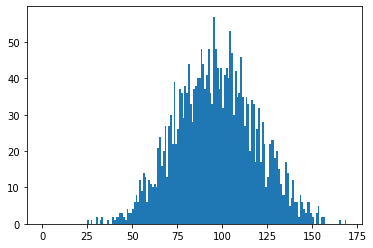


moyenne: 96.202

variance: 500.4323960000001


* **Classe blanche -** $P(Y_s|X_s=0)$

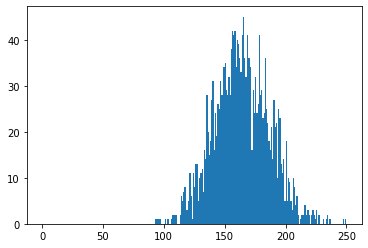

moyenne: 163.7342857142857

variance: 516.6589197278912


## 1.1 : Optimisation par recherche de coupure minimale


1. Combien de noeuds possède le  graphe qui est construit pour la recherche de la coupe de capacité minimale avec seulement deux pixels voisins ? À quoi correspondent t'ils ? À quoi correspondent les termes d'attache aux données dans ce graphe et quelles valeurs ont-ils pour deux pixels observés de valeurs $y_s$ et $y_t$ ? À quoi correspond le terme de régularisation ?

**Votre réponse &#x270D;** : 

Ils ont 4 noeuds:

* 1 noeud corresponde à Classe 0 (source).
* 1 noeud corresponde à classe 1 (puit). 
* 1 noeuds correspondente à chaque pixel de l'image (2 noeuds).

Les termes d'atache aux donnés sont correspondents aux arcs entre la source et chaque pixel pour la classe 0 ($D(0,y_p)$  et $D(0,y_t)$) et entre le puit et chaque pixel pour la classe 1 ($D(1,y_p)$  et $D(1,y_t)$). Où ici, $D(x,y_p) = (y_p - \text{moyenne de la classe x})^2$ .

Le terme de regularisation correspond à l'arc entre les noeuds des pixels et a le valeur $\beta$.



2. Complétez la cellule de code python où il est indiqué "#A COMPLETER EXO1" avec les termes d'attache aux données et de régularisation comme indiqué. Exécutez l'algorithme de coupure minimale et visualisez le résultat.



##1.2 Recherche du $\beta$ optimal



3. En complétant la trame de programme fourni ci-dessous, trouvez la valeur de $\beta$ optimale $\beta_{opt}$ en utilisant l'"image vraie" $x$ correspondant à IoriginaleBW.png. On pourra tracer la courbe des valeurs de l'erreur entre $x$ et l'estimée $\hat{x}$ pour trouver $\beta_{opt}$. 



**Votre réponse &#x270D;** : 


Nous pouvons voir ci-dessous la courbe des valeurs d'erreur. Nous avons que $ \beta $ optimal est égal à 1750, ce qui nous donne l'équilibre idéal entre la régularisation et le terme attaché aux données.



4. Quels sont les intérêts de cette approche d'optimisation par rapport à l'ICM ? Par rapport au recuit simulé ? En théorie obtient-on le même résultat avec les deux méthodes ? Sous quelles conditions ? Quel est l'intérêt du recuit simulé dans le cas général ?

**Votre réponse &#x270D;** : 

L'avantage de l'ICM c'est qu’il est une méthode de convergence très vite, mais par contre il converge vers un minimum local, donc le résultat dépend beaucoup de la configuration initiale.

Par contre, le recuit simulé nous donne un minimum global, mais comme nous devons baisser la température très lentement, c’est une méthode de convergence très lente.

 En théorie nous obtenons le même résultat pour la coupure minimale et recuit simulé toujours (c’est le minimum global). Pour le ICM, il va avoir le même résultat avec une bonne configuration initiale.

 L’intérêt du recuit simulé est qu’il trouve le minimum global dans tous les cas. La recherche de la coupe minimale est plus rapide et nous donne le minimum global, mais seulement pour certaines énergies.




5. Comment expliquer que le taux d'erreurs avec l'image vraie puisse être plus faible avec le résultat du recuit simulé ou l'ICM qu'avec l'optimisation par graph-cut ? 
  

**Votre réponse &#x270D;** :

La solution dugraph-cut est la solution optimale, c’est-à-dire, le minimum global. Si nous n’avonspas obtenu de bons résultats, le problème c’est que le modèle utilisé a été inadéquatpour l’image (il est encore le minimum).

Donc, c’estpossible d’obtenir une erreur plus faible avec le recuit simulé ou l’ICM si le modèleutilisé dans ces algorithmes d’optimisation sont plus adaptés. 



6. Quels sont les avantages et inconvénients du modèle d'Ising ?

**Votre réponse &#x270D;** : 

L'un des avantages est qu'il s'agit d'un modèle très simple et de implementation facile. Un inconvénient est que ce modèle favorise les images avec tous les pixels blancs ou noirs, ce qui peut nous donner des résultats étranges au cas où nous choisirions un $ \beta $ très grand.

In [ ]:
#Chargement des images

im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Image observée, bruitée
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Image binaire de réference, pour évaluer la qualité de la segmentation

affiche(im_obs,titre='Image observée')


(323, 361, 4)


In [ ]:
#### to be completed
#A COMPLETER EXO1
beta =  1750 # beta value 
m0 =   96 # m0 and m1 values from the previous practical work
m1 = 164

## binary graph-cut

# Create the graph.
g = maxflow.Graph[float]() #Instanciation du graph

# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity
g.add_grid_edges(nodeids, beta) 

# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink
g.add_grid_tedges(nodeids, (im_obs-m0)**2, (im_obs-m1)**2) 

# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the labels of the nodes in the grid.
# output is 0 if the node is connected to the source, else output is 1 
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin,titre = "Résultat pour beta = " + str(beta))
#%%


Max Flow: 76480405.0
(323, 361, 4)


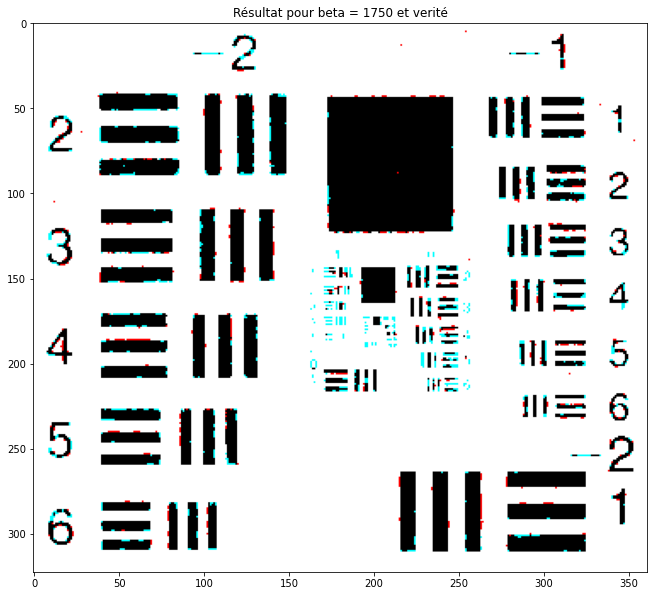

Nombre de pixels mal classés pour beta =  1750 :  2203


In [ ]:
# compute the error image between im_bin and im_orig (the ideal solution) using np.abs and np.sum 
error = np.sum(np.abs(im_orig-im_bin))

# visualize the differences between the original image and the solution
plt.figure()
plt.imshow(np.dstack((np.int_(im_orig), im_bin, im_bin))*255)
plt.title("Résultat pour beta = " + str(beta) + " et verité")
plt.show()

print("Nombre de pixels mal classés pour beta = ",beta,": ",int(error))

### Recherche du meilleur paramètre $\beta$

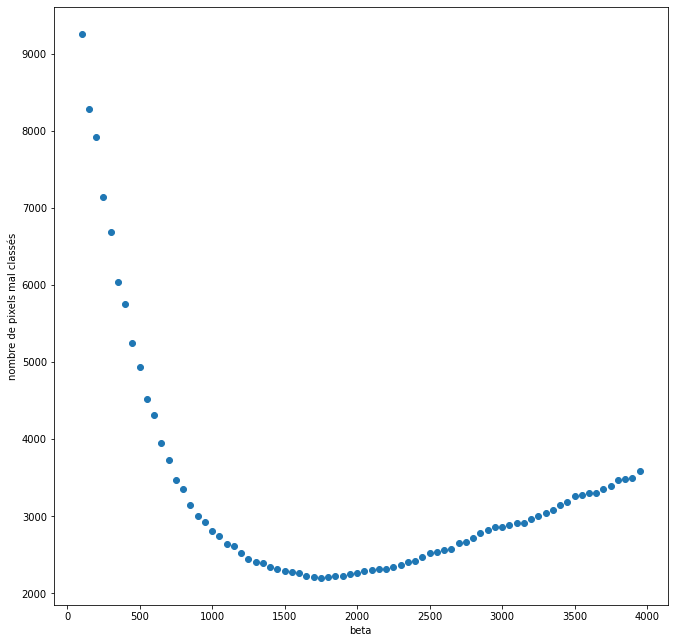

Meilleure valeur de beta :  1750


In [ ]:
im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Image observée, bruitée
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Image binaire de réference, pour évaluer la qualité de la segmentation

list_beta = []
list_errors = []

#A COMPLETER - choisissez un intervalle de valeurs et un pas pour étudier beta
for beta in range(100,4000,50):
    #A COMPLETER
    m0 = 96
    m1 = 164

    ## Graph cut binaire

    # Create the graph.
    g = maxflow.Graph[float]() #Instanciation du graph

    # Add the nodes. nodeids has the identifiers of the nodes in the grid.
    nodeids = g.add_grid_nodes(im_obs.shape) 
    # Add non-terminal edges with the same capacity.
    g.add_grid_edges(nodeids,beta) 
    # Add the terminal edges.
    g.add_grid_tedges(nodeids, (im_obs-m0)**2, (im_obs-m1)**2) 

    # Find the maximum flow.
    flow = g.maxflow()

    # Get the segments of the nodes in the grid.
    sgm = g.get_grid_segments(nodeids) 
    # create the output image 
    im_bin = np.int_(np.logical_not(sgm))

    #print("beta = ",beta)
    # compute the error
    error = np.sum(np.abs(im_orig-im_bin))  
    list_beta.append(beta)
    list_errors.append(error)

plt.figure()
plt.scatter(list_beta,list_errors)
plt.xlabel("beta")
plt.ylabel("nombre de pixels mal classés")
plt.show()

meilleur_beta = list_beta[np.argmin(np.array(list_errors))]

print('Meilleure valeur de beta : ', meilleur_beta)

## 2. Classification d’une image couleur

L'objectif de cette partie est de réaliser une extension de la méthode vue précédemment dans le cas du traitement d'une image couleur *avions.png* dans laquelle on veut séparer les objets du fond.

On va dans un premier utiliser le mêême cadre (modèle d'Ising) que précédemment mais avec une attache aux données tri-dimensionnelle (en supposant des matrices de convariance égales à l'identité). Puis on va introduire un CRF (conditional random field) en pondérant le terme de régularisation du modèle d'Ising par le module du gradient entre deux pixels de l'image observée.  

###2.1 Classification binaire
A partir de l'ossature de programme ci-dessous réalisez les différentes étapes nécessaires à cette classification :
1. Modélisation des distributions du fond et des objets (en 3 dimensions cette fois)
1. Définition du terme d'attache aux données
1. Choix d'une valeur du paramètre de régularisation pour le modèle d'Ising
1. Recherche de la coupure minimale pour obtenir la classification objet / fond.

Commentez ces étapes et les résultats obtenus

 **Votre réponse &#x270D;** : 

Dans ce cas, il faut trouver la moyenne du fond (ciel) et des plans pour les trois composants séparément. On considère que le terme attaché aux données est égal à la somme de la différence au carré, cela implique que l'on considère qu'il n'y a pas de corrélation entre les trois composantes de couleur.

Pour le terme de régularisation, nous avons essayé de trouver une bonne valeur qui ne classerait pas le ciel comme un avion, ce qui nous a donné des résultats acceptables, avec de petites erreurs de classification aux bords des avions.



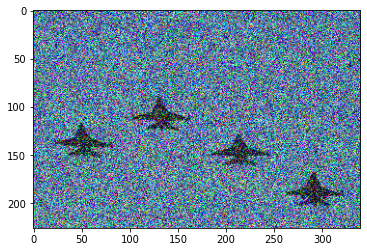

In [ ]:
#Chargement et affichage de l'image
im_obs=plt.imread('https://www.dropbox.com/s/ylm0ut8ipu5oonb/avions.png?dl=1')

plt.figure()
#plt.imshow(im_obs,vmin=0,vmax=255)
plt.rcParams['figure.figsize'] = [15, 15]
plt.imshow(im_obs)
plt.show()


# conversion of the image between 0 and 255
im_obs=255*im_obs

Détermination des paramètres des classes


Classe avions : on pourra utiliser les valeurs du rectangle [180:200,280:300] 

exemple np.mean(image[180:200,280:300,1]) renvoie la moyenne de la zone sélectionnée pour le canal 1



In [ ]:


# mean of the plane class - 3D vector
m_avions =  [np.mean(im_obs[180:200,280:300,i]) for i in range(3)]

# mean of the sky class
# you can use values in the following square [0:100,150:300]
m_ciel = [np.mean(im_obs[0:100,150:300,i]) for i in range(3)]

print('Pour le ciel, [R,G,B] = ', m_ciel)
print("Pour l'avion, [R,G,B] = ", m_avions)

# check that the obtained values are coherent

Pour le ciel, [R,G,B] =  [93.961266, 127.144264, 156.2286]
Pour l'avion, [R,G,B] =  [53.645, 56.4725, 70.2075]


In [ ]:
# choose a beta value 
beta = 15000

## binary graph-cut

# Create the graph.
g = maxflow.Graph[float]() #Instanciation du graph

# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape[0:2]) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity
g.add_grid_edges(nodeids, beta) 

# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink
g.add_grid_tedges(nodeids, np.sum((im_obs[:,:,i]-m_ciel[i])**2 for i in range(3)), (np.sum((im_obs[:,:,i]-m_avions[i])**2 for i in range(3))))

# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the labels of the nodes in the grid.
# output is 0 if the node is connected to the source, else output is 1 
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin,titre = "Résultat pour beta = " + str(beta))
#%%


Max Flow: 1092089223.1822605
(226, 340, 4)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:21: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.


###  2.2 Utilisation d'un modèle CRF (Conditional Random Field)

On cherchera ici à adapter le modèle utilisé précedemment pour favoriser les transitions là où elles sont compatibles avec le gradient. Pour cela, on remplacera le $\beta$ constant pour toute l'image par un champ "beta_field" qui dépend de la norme du gradient.

1. Calculez et affichez le module du gradient de l'image avions après passage en niveaux de gris et convolution par un noyau gaussien d'écart type 1. Pourquoi utiliser l'option "boundary='symm'" lors de la convolution par le filtre de Sobel ? Essayez sans faire le filtrage gaussien. Quel est son intérêt ? 


**Votre réponse &#x270D;** : 

Pour éviter la détection des faux contours sur les bordes de l'image. (si nous n'utilison pas cette option, il va faire du padding).

Sans le filtrage gaussien nous obtenons le résultat pour le gradient très fort sur tout l'image (nous ne pouvons pas observer le contour) à cause des variations de niveaux de gris local très fort. Ce qui nous donne de pires résultats.


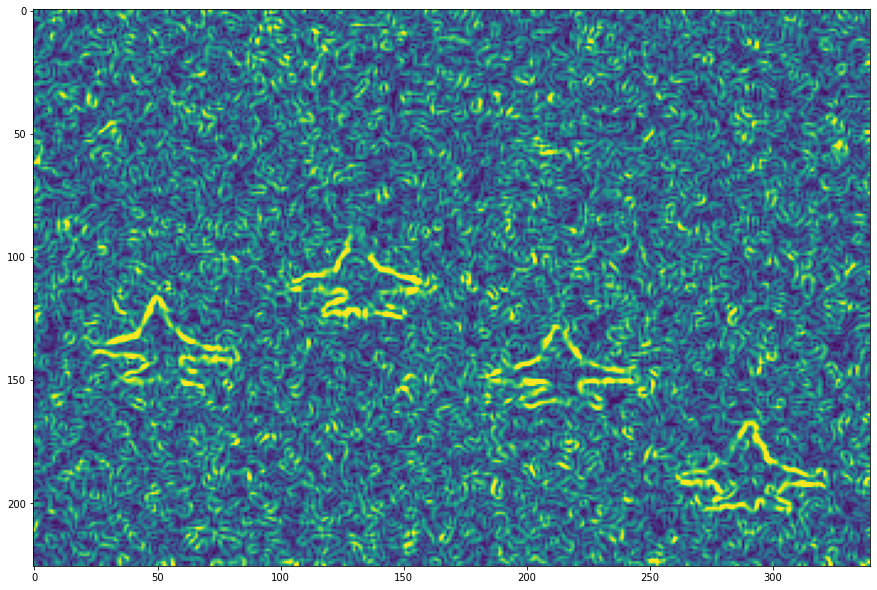

In [ ]:
import scipy.signal
import scipy.ndimage
from skimage import color

def gradient(image):
    """ Array -> tuple[Array*Array]"""
    sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype = np.float)
    sobel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype = np.float)
    # à compléter 
    # utiliser mode = 'same' et boundary='symm' dans scipy.signal.convolve2d
    derivee_x = scipy.signal.convolve2d(image,sobel_x, mode = 'same',boundary='symm')
    derivee_y = scipy.signal.convolve2d(image,sobel_y, mode = 'same',boundary='symm')
    return([derivee_x,derivee_y])

avion_nb = scipy.ndimage.gaussian_filter(color.rgb2gray(im_obs), 1)
avion_x, avion_y = gradient(avion_nb)
# calcul du module du gradient 
grad_av = np.sqrt(avion_x**2+avion_y**2)
plt.figure()
plt.imshow(grad_av, vmax=200)
plt.show()


Completez le code de la segmentation par CRF. On 
choisira $beta\_field=\beta_2\cdot\exp(-grad\_av/h)$ On pourra utiliser $h=300$ et $\beta_2=20000$. Remplacer également la constante beta par le champ "beta_field" lors de l'étape "g.add_grid_edges".

Comparer les résultats avec et sans le terme de contours.

**Votre réponse &#x270D;** : 


Nous pouvons observer qu'en utilisant le gradient nous avons une meilleure détection dans les contours, mais comme c'est une image très simple, la différence nést pas très grande.

In [ ]:
# calcul de beta_field 
# ce champ définira la valeur pour les 4-voisins 
h = 300
beta2 = 20000
beta_field = beta2 * np.exp(-grad_av/h)

# Create the graph.
g = maxflow.Graph[float]() #Instanciation du graph

# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape[0:2]) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity
g.add_grid_edges(nodeids, beta_field) 

# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink
g.add_grid_tedges(nodeids, np.sum((im_obs[:,:,i]-m_ciel[i])**2 for i in range(3)), (np.sum((im_obs[:,:,i]-m_avions[i])**2 for i in range(3))))

# Find the maximum flow.
flow = g.maxflow()


# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) # Renvoie 1 si le pixel est du coté du drain après calcul de la coupe min, 0 si il est du coté de la source
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin, titre="Résultat pour le modèle CRF")

(226, 340, 4)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:22: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.


## 3. Segmentation itérative avec mélange de Gaussiennes

3.1 Affichez l'image "zebre" ci-dessous. Est il possible de segmenter le zebre avec la méthode utilisée pour segmenter les avions ?



**Votre réponse &#x270D;** : 


Non, ce n'est pas possible étant donné la très grande différence dans les poils du zèbre (noir et blanc), qui se traduira par une classification qui divise ces deux, pas le zèbre et le fond.

uint8


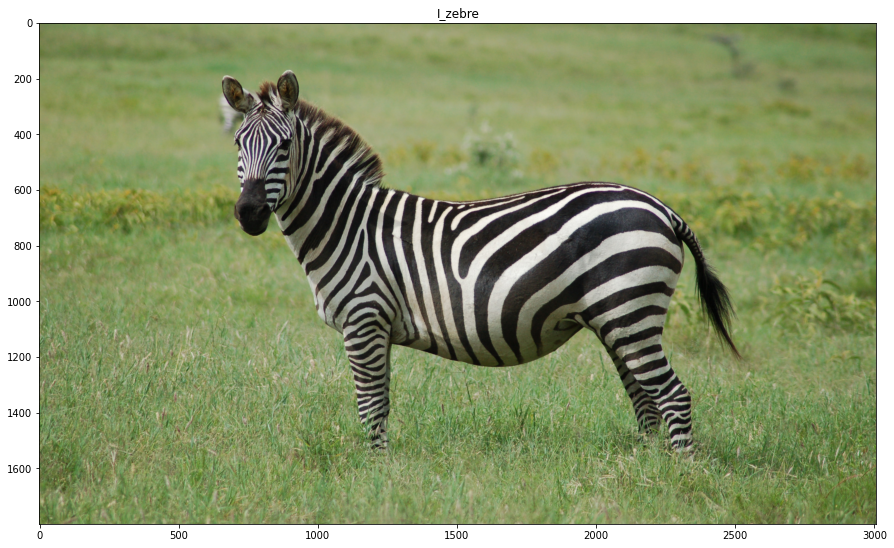

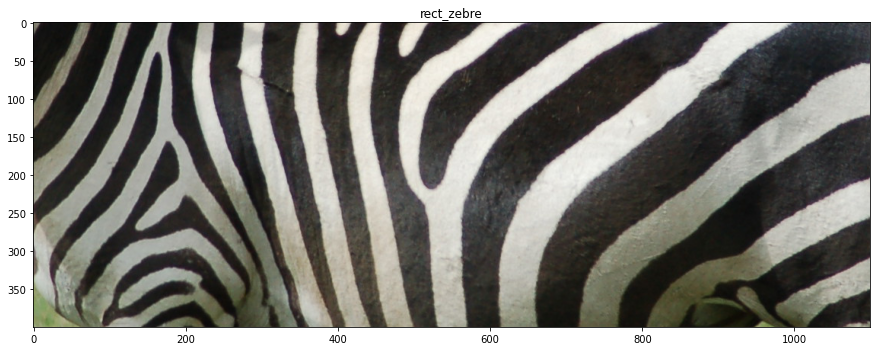

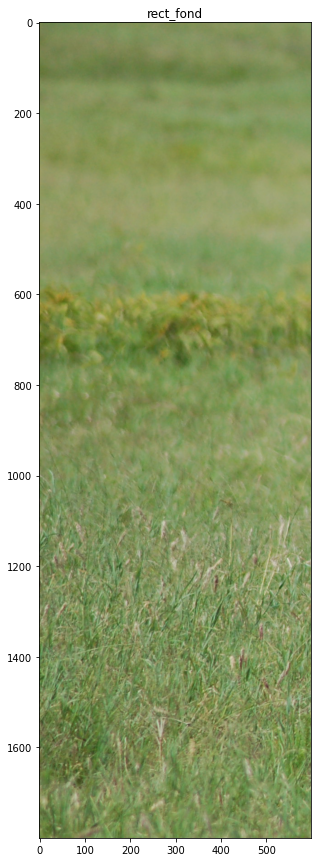

In [ ]:
###   Chargement d'une nouvelle image
import imageio
I_zebre = imageio.imread('https://upload.wikimedia.org/wikipedia/commons/6/60/Equus_quagga.jpg')
I_zebre = I_zebre[200:,:,:]
rect_zebre = I_zebre[700:1100,1000:2100]
rect_fond = I_zebre[:,0:600]
print(I_zebre.dtype)

plt.figure()
plt.imshow(I_zebre)
plt.title('I_zebre')
plt.show()

plt.figure()
plt.imshow(rect_zebre)
plt.title('rect_zebre')
plt.show()

plt.figure()
plt.imshow(rect_fond)
plt.title('rect_fond')
plt.show()

3.2 Calculez les matrice de covariance pour le rectangle "rect_zebre" et pour le rectangle "rect_fond". Affichez les valeurs et commentez le résultat. À quoi correspondent les valeurs diagonales ?

**Votre réponse &#x270D;** : 


Les valeurs diagonales correspondent à la variance pour chaque couleur.


Les résultats ont du sens. Comme le zèbre est noir et blanc, il a une valeur de variance similaire pour les trois cannaux. Le fond vert a une plus petite variance pour la composante verte.



In [ ]:
print(I_zebre.shape)
V_tulip = np.vstack([I_zebre[:,:,i].flatten() for i in range(3)])
print(I_zebre.shape)

M_cov = np.cov(np.vstack([I_zebre[:,:,i].flatten() for i in range(3)]))
print('Image zebre entière')
print(M_cov)

M_cov = np.cov(np.vstack([rect_zebre[:,:,i].flatten() for i in range(3)]))
print('Rectangle zebre')
print(M_cov)

M_cov = np.cov(np.vstack([rect_fond[:,:,i].flatten() for i in range(3)]))
print('Rectangle fond')
print(M_cov)

(1800, 3008, 3)
(1800, 3008, 3)
Image zebre entière
[[1506.72829498 1532.31063252 1229.07656578]
 [1532.31063252 1691.94506099 1220.3208793 ]
 [1229.07656578 1220.3208793  1210.38796242]]
Rectangle zebre
[[5504.24135104 5535.45173735 5287.6066819 ]
 [5535.45173735 5589.55992729 5327.41135684]
 [5287.6066819  5327.41135684 5140.71619284]]
Rectangle fond
[[314.66520718 225.26933203 255.5870428 ]
 [225.26933203 219.9126776  221.64616138]
 [255.5870428  221.64616138 309.65375015]]


3.3 Affichez l'histogramme pour les cannaux R,G et B pour l'image "rect_zebre". Commenter le résultat.

**Votre réponse &#x270D;** : 


Nous pouvons voir que les distributions pour le zèbre montrent deux classes différentes (correspondant au noir et blanc), tandis que le fond a une seule classe pour les trois cannaux de couleur.




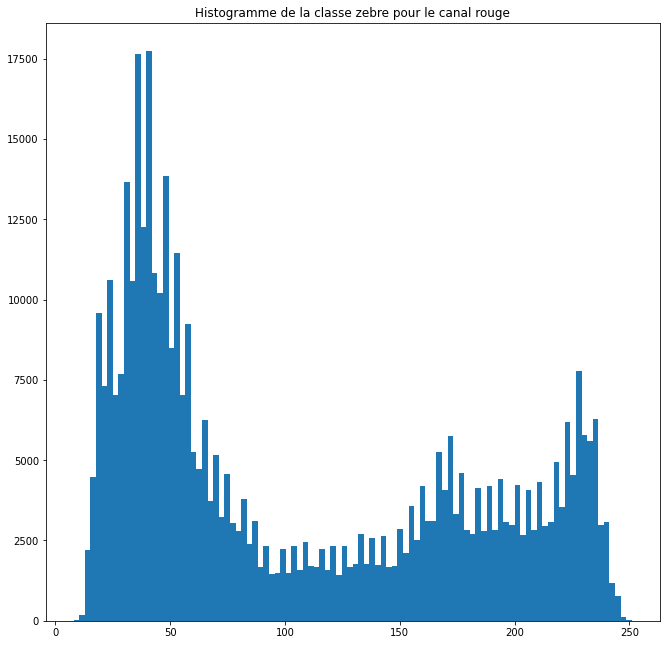

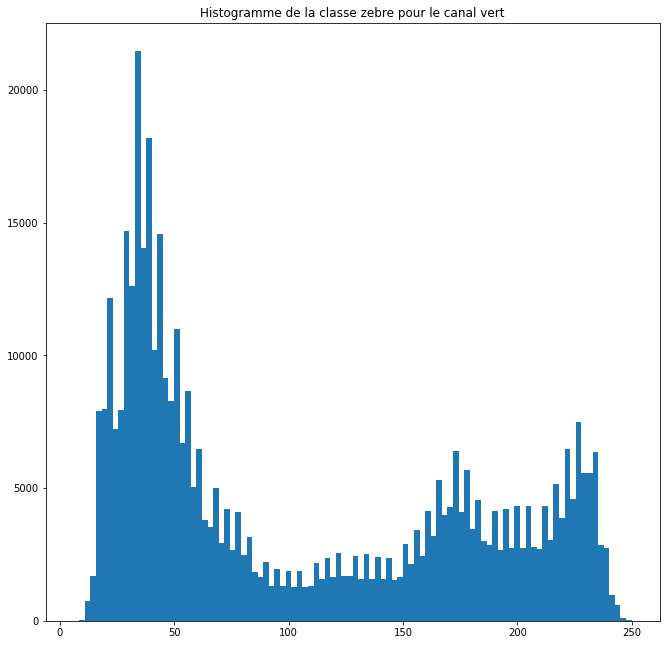

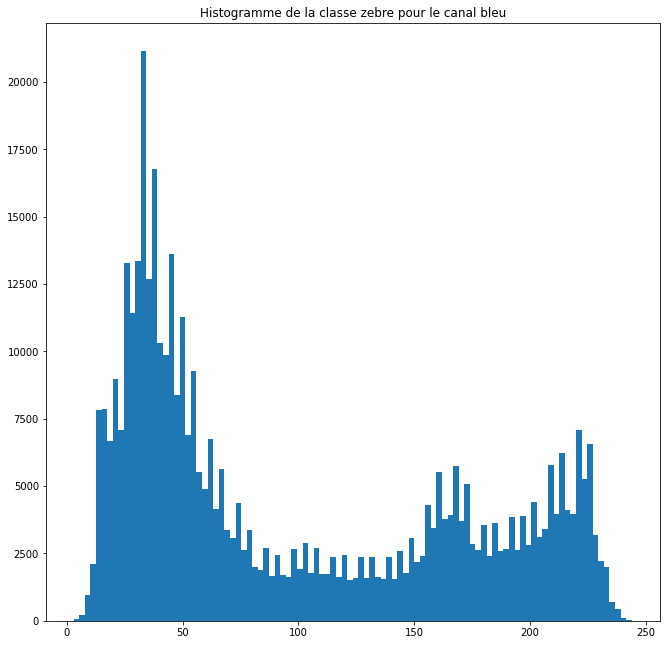

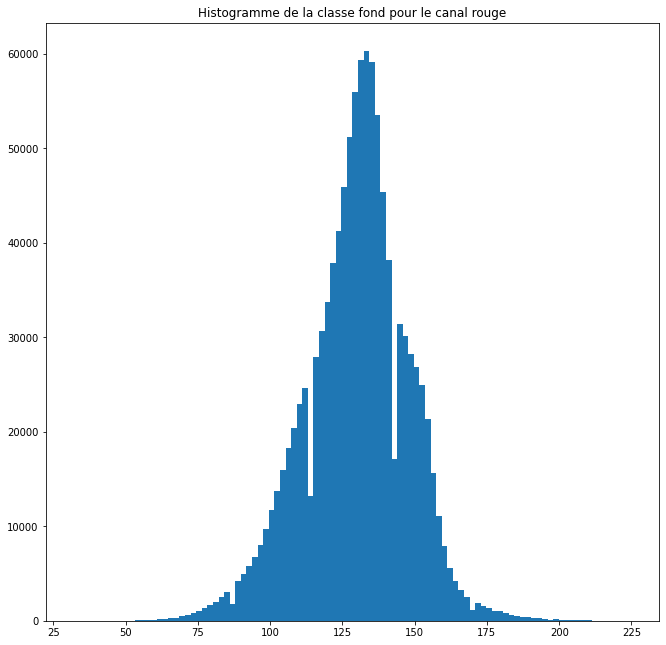

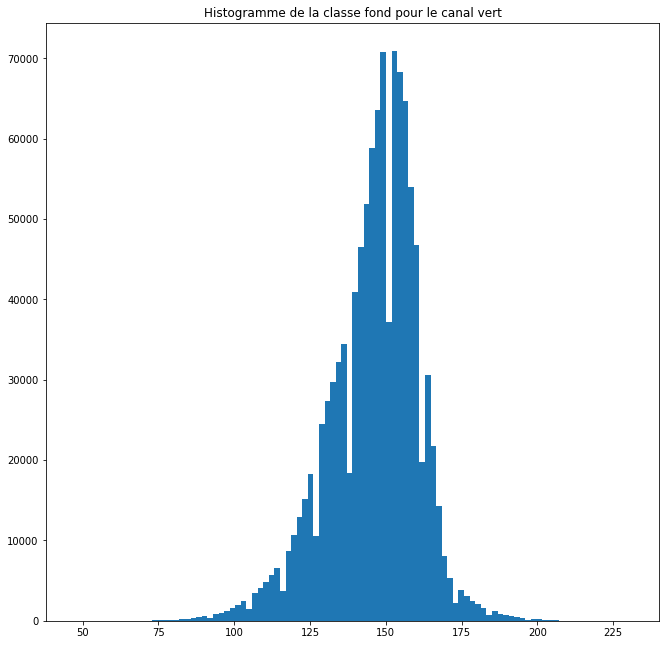

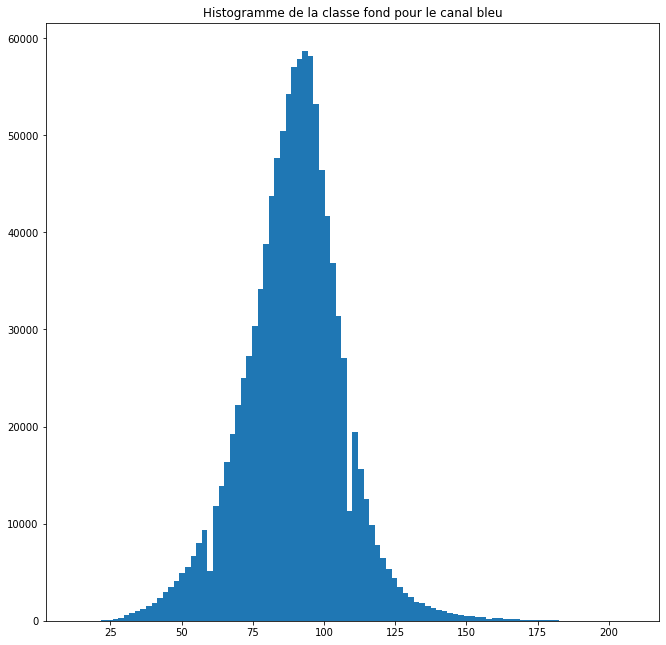

In [ ]:
# permet de modifier la taille de l'affichage de plt.show
plt.rcParams['figure.figsize'] = [11, 11]

nomchan = ["rouge","vert", "bleu"]
for chan in range(3):
    plt.figure()
    plt.hist(rect_zebre[:,:,chan].flatten(),100)
    plt.title("Histogramme de la classe zebre pour le canal " + nomchan[chan])
    plt.show()
    
    
for chan in range(3):
    plt.figure()
    plt.hist(rect_fond[:,:,chan].flatten(),100)
    plt.title("Histogramme de la classe fond pour le canal " + nomchan[chan])
    plt.show()

3.4 Proposez une méthode algorithmique pour identifier les deux classes de l'image "rect_zebre". Utilisez une implementation sklearn de cet algorithme pour identifier les vecteurs moyens ($m_R$,$m_G$,$m_B$) pour deux classes de l'image "rect_zebre" et deux classes de l'image "rect_fond".

*On pourra utiliser la ligne de code suivante pour transformer l'image sous une forme adaptée.*

X = np.vstack([rect_zebre[:,:,i].flatten() for i in range(3)]).transpose()

Commentez les vecteurs moyens obtenus. On pourra les afficher sous forme d'image en utilisant le code fourni.
 
 





**Votre réponse &#x270D;** : 

Le k-means donneront des moyennes de classe qui maximisent la différence entre les clusters.

Nous pouvons voir que k-means nous donne le résultat de classe attendu pour le zèbre (noir et blanc), et aussi pour le fond (deux nuances de vert).

In [ ]:
# calcul des paramètres des classes de façon semi-automatique
from sklearn.cluster import KMeans
import numpy as np

#utilisez un nombre de classes =2 pour la partie zèbre (compléter n_clusters=?)
X = np.vstack([rect_zebre[:,:,i].flatten() for i in range(3)]).transpose()
kmeans_zebre = KMeans(n_clusters=2, random_state=0).fit(X)
mean_vectors_zebre = kmeans_zebre.cluster_centers_

#utilisez un nombre de classes =2 pour la partie fond
X = np.vstack([rect_fond[:,:,i].flatten() for i in range(3)]).transpose()
kmeans_fond = KMeans(n_clusters=2, random_state=0).fit(X)
mean_vectors_fond = kmeans_fond.cluster_centers_

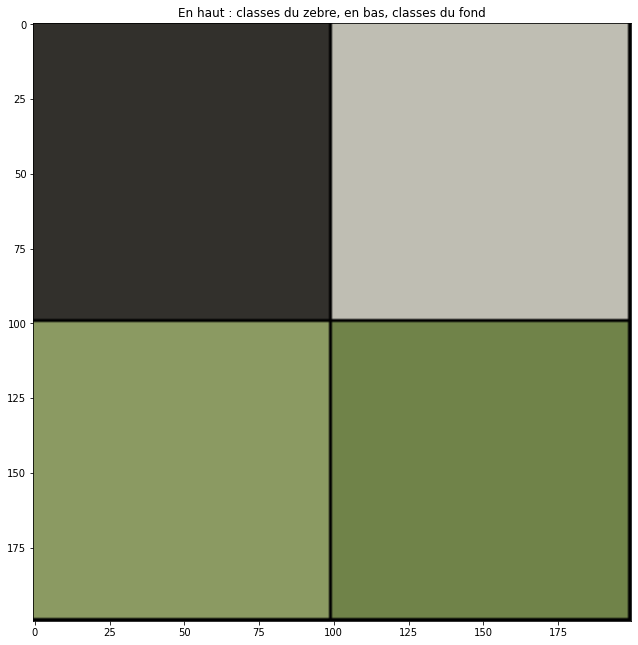

In [ ]:
# affichage des centres de classes trouvés sous forme d'image
image_mean_vectors = np.zeros((200,200,3),np.uint8)
for i in range(3):
    image_mean_vectors[0:99,0:99,i] = mean_vectors_zebre[0,i]
    image_mean_vectors[0:99,100:199,i] = mean_vectors_zebre[1,i]
    image_mean_vectors[100:199,0:99,i] = mean_vectors_fond[0,i]
    image_mean_vectors[100:199,100:199,i] = mean_vectors_fond[1,i]

plt.figure()
plt.imshow(image_mean_vectors,vmax = 255)
plt.title("En haut : classes du zebre, en bas, classes du fond")
plt.show()

3.5 Afficher séparément deux image de neg-log-vraisemblance (la neg-log-vraisemblance servait d'attache aux données dans l'exemple précédent) pour les deux classes du zebre.
Construire une image de neg-log-vraisemblance correspondant au minimum des deux neg-log-vraisemblance des classes zebre. De même pour la classe fond. 

Affichez les et commentez.

**Votre réponse &#x270D;** :


Nous pouvons voir dans les résultats combinés une nette différence entre le zèbre et le fond, mais à certains endroits sur le bord (principalement à cause des rayures), ces différences ne sont pas si nettes. Avec cela, nous pouvons  attendre à des classifications erronées sur les bords.

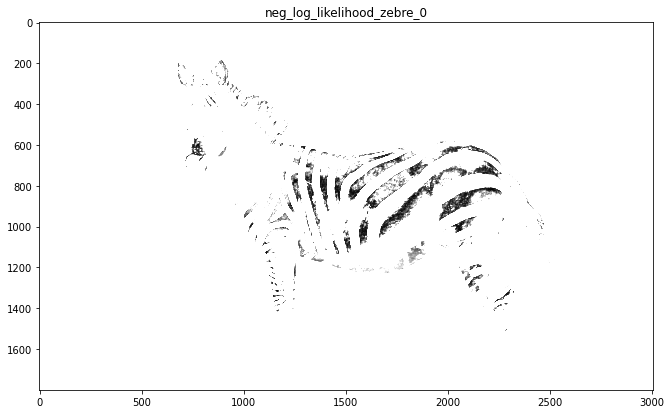

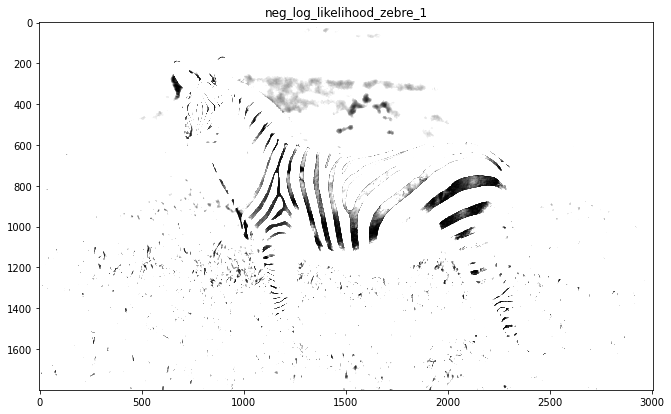

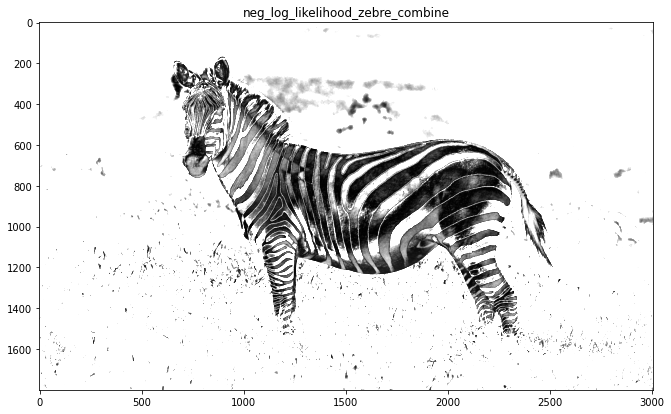

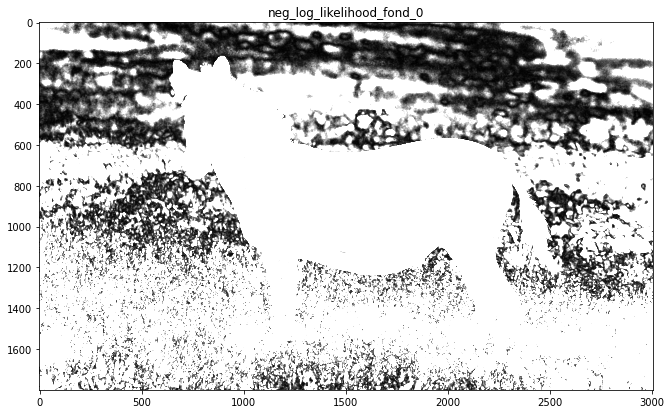

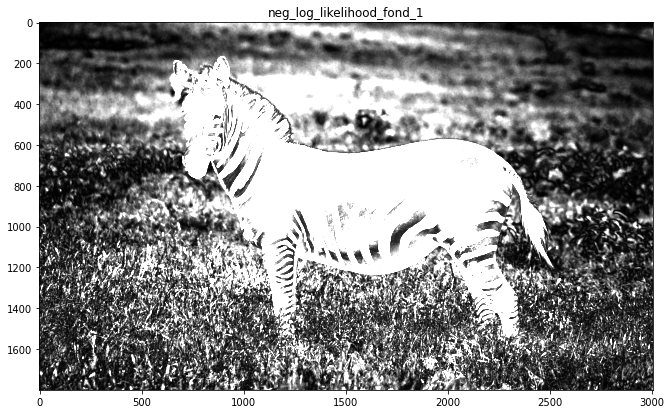

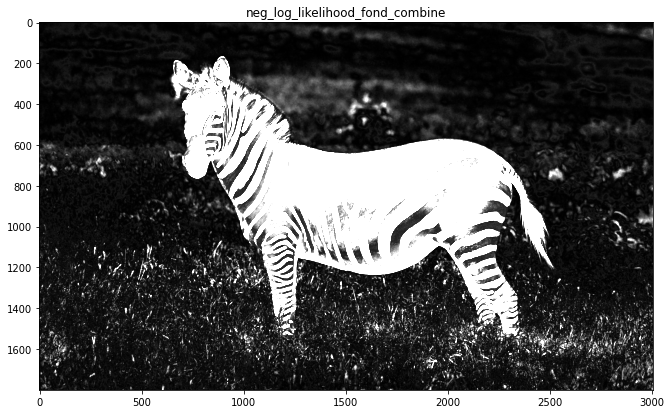

In [ ]:
# calcul de l'attache aux données (neg-log-likelihood) de la classe zebre
neg_log_likelihood_zebre_0 = sum((I_zebre[:,:,i]-mean_vectors_zebre[0,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_zebre_0,cmap='gray', vmax = 600)
plt.title("neg_log_likelihood_zebre_0")
plt.show()

neg_log_likelihood_zebre_1 = sum((I_zebre[:,:,i]-mean_vectors_zebre[1,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_zebre_1,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_zebre_1")
plt.show()

neg_log_likelihood_zebre_combine = np.minimum(sum((I_zebre[:,:,i]-mean_vectors_zebre[0,i])**2 for i in range(3)),sum((I_zebre[:,:,i]-mean_vectors_zebre[1,i])**2 for i in range(3)))

plt.figure()
plt.imshow(neg_log_likelihood_zebre_combine,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_zebre_combine")
plt.show()

# A COMPLETER
# calcul de la neg-log-likelihood du fond 
# appeler la sortie neg_log_likelihood_fond_combine

neg_log_likelihood_fond_0 = sum((I_zebre[:,:,i]-mean_vectors_fond[0,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_fond_0,cmap='gray', vmax = 600)
plt.title("neg_log_likelihood_fond_0")
plt.show()

neg_log_likelihood_fond_1 = sum((I_zebre[:,:,i]-mean_vectors_fond[1,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_fond_1,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_fond_1")
plt.show()

neg_log_likelihood_fond_combine = np.minimum(sum((I_zebre[:,:,i]-mean_vectors_fond[0,i])**2 for i in range(3)),sum((I_zebre[:,:,i]-mean_vectors_fond[1,i])**2 for i in range(3)))

plt.figure()
plt.imshow(neg_log_likelihood_fond_combine,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_fond_combine")
plt.show()




3.6 À partir de ces images d'attache aux données combinées (une pour le fond et une pour le zebre), mettez en place une segmentation de l'image par graph-cut avec le $\beta$ de votre choix. Commentez le résultat.

**Votre réponse &#x270D;** : 

Nous avons obtenu un résultat acceptable, car nous avons réussi à différencier le zèbre de le fond, c'est-à-dire qu'il n'y a pas eu d'erreur de classification entre les rayures zébrées.

Mais il est important de mettre en évidence les mauvais résultats sur les bords du zèbre, comme l'oreille et la queue.

Max Flow: 7266323069.252993


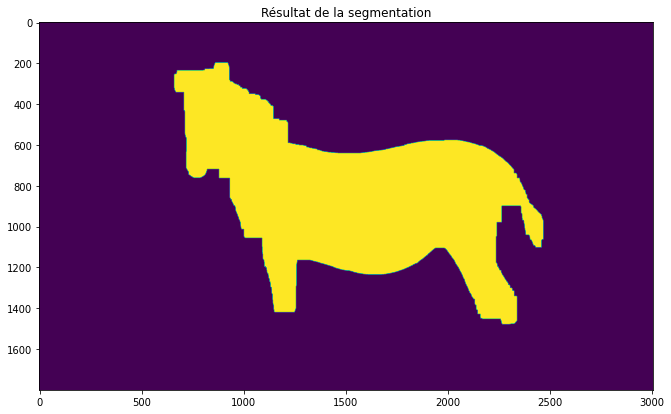

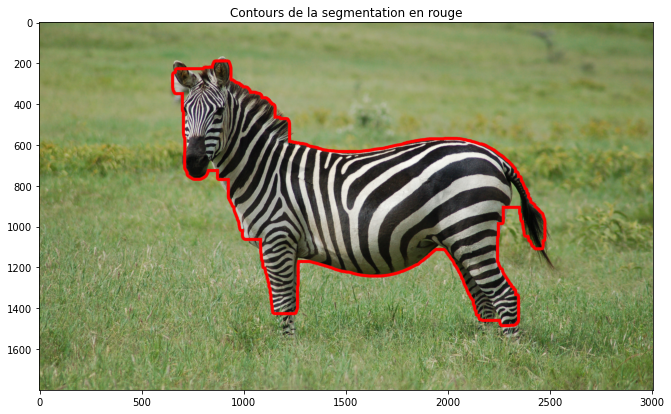

In [ ]:
beta =  250000# Valeur optimale de beta à déterminer

## Graph cut binaire

# Create the graph.
g = maxflow.Graph[float]() #Instanciation du graph
# Add the nodes. nodeids has the identifiers of the nodes in the grid.
nodeids = g.add_grid_nodes(I_zebre.shape[0:2]) # Création d'une grille comportant un noeud non terminal pour chaque pixel de l'image
# Add non-terminal edges with the same capacity.
g.add_grid_edges(nodeids, beta) # Ajout d'une arête de poids beta entre chaque noeud adjacent selon la 4-connexité
# Add the terminal edges.

# A COMPLETER 
g.add_grid_tedges(nodeids,neg_log_likelihood_fond_combine ,neg_log_likelihood_zebre_combine) 


# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

plt.figure()
plt.imshow(im_bin)
plt.title("Résultat de la segmentation")
plt.show()

plt.figure()
plt.imshow(display_segmentation_borders(I_zebre, im_bin))
plt.title("Contours de la segmentation en rouge")
plt.show()


3.7 À partir de la segmentation obtenue, determinez les vecteurs moyens pour 5 classes pour le fond et 5 classes pour le zebre. Utilisez ces listes de vecteurs moyens pour construire de nouvelles images de combinaison de neg-log-vraisemblance. Commentez les.

**Votre réponse &#x270D;** : 


Les images négatives dans le journal sont beaucoup plus proches que prévu, séparant mieux le fond et le zèbre (plus grand contraste entre eux).

In [ ]:
# Le calcul de cette cellule peut prendre plusieurs minutes.

X_1 = np.vstack([I_zebre[im_bin==1,i].flatten() for i in range(3)]).transpose()
kmeans_zebre2 = KMeans(n_clusters=5, random_state=0).fit(X_1)
mean_vectors_zebre2 = kmeans_zebre2.cluster_centers_

X_2 = np.vstack([I_zebre[im_bin==0,i].flatten() for i in range(3)]).transpose()
kmeans_fond2 = KMeans(n_clusters=5, random_state=0).fit(X_2)
mean_vectors_fond2 = kmeans_fond2.cluster_centers_


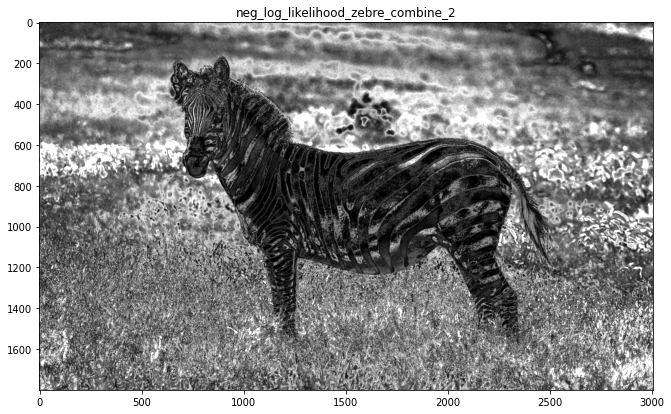

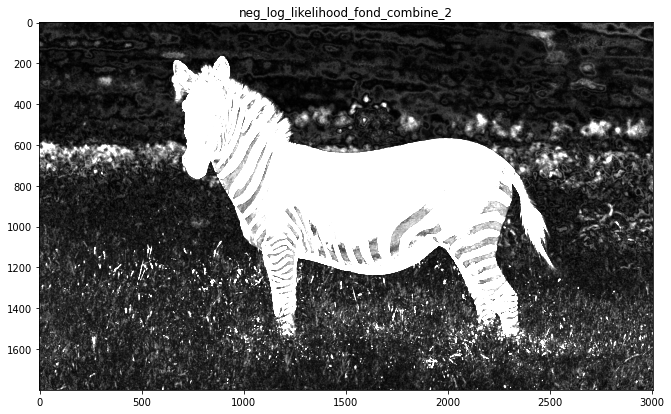

In [ ]:
neg_log_likelihood_zebre_combine_2 = np.amin(np.dstack([(sum((I_zebre[:,:,i]-mean_vectors_zebre2[n_cl,i])**2 for i in range(3))) for n_cl in range(len(mean_vectors_zebre2))]),2)

neg_log_likelihood_fond_combine_2 = np.amin(np.dstack([(sum((I_zebre[:,:,i]-mean_vectors_fond2[n_cl,i])**2 for i in range(3))) for n_cl in range(len(mean_vectors_fond2))]),2)

plt.figure()
plt.imshow(neg_log_likelihood_zebre_combine_2 ,cmap='gray', vmax = 3000)
plt.title("neg_log_likelihood_zebre_combine_2")
plt.show()

plt.figure()
plt.imshow(neg_log_likelihood_fond_combine_2,cmap='gray', vmax = 1000)
plt.title("neg_log_likelihood_fond_combine_2")
plt.show()


3.8 À partir de ces images de neg-log-vraisemblance, segmenter l'image par graph-cut en utilisant une nouvelle valeur de $\beta$ qui vous donne le meilleur résultat. Commentez le résultat obtenu et la nouvelle valeur de $\beta$ qui vous a permis de l'obtenir. Que dire de la nouvelle attache aux données à 5 classes par rapport à la précédente ?







**Votre réponse &#x270D;** : 

Les résultats pour 5 classes sont beaucoup plus meilleurs que pour 2 classes, avec très peu d'erreurs de classification sur les bords.

Nous avons obtenu un bon résultat pour $ \beta $ égal à 14000 au lieu de 250000 de la question précédente. Cela signifie que nous avons besoin d'une régularisation beaucoup plus faible pour obtenir de bons résultats. (les termes d'attache au donnés étaient plus proches d'un bon résultat).

Max Flow: 1486080337.474862
(1800, 3008, 4)


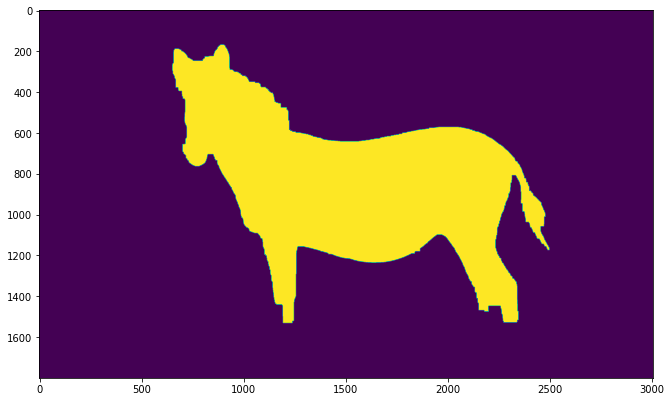

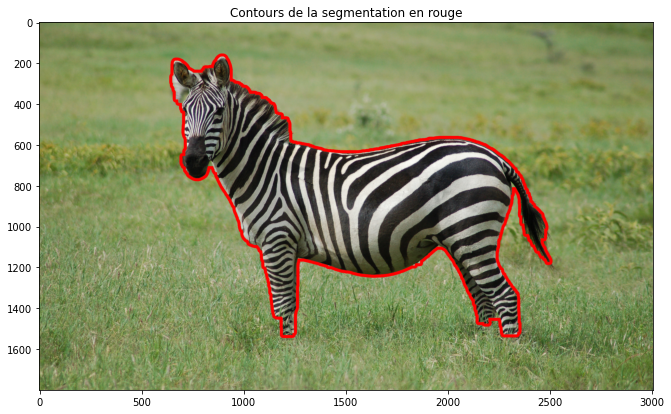

In [ ]:

beta =  14000# Valeur optimale de beta à déterminer

g = maxflow.Graph[float]() #Instanciation du graph
# Add the nodes. nodeids has the identifiers of the nodes in the grid.
nodeids = g.add_grid_nodes(I_zebre.shape[0:2]) 
# Add non-terminal edges with the same capacity.
g.add_grid_edges(nodeids, beta)
# Add the terminal edges.
g.add_grid_tedges(nodeids,neg_log_likelihood_fond_combine_2, neg_log_likelihood_zebre_combine_2) 

flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) # Renvoie 1 si le pixel est du coté du drain après calcul de la coupe min, 0 si il est du coté de la source
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin, titre="Résultat pour beta = " + str(beta));

plt.figure()
plt.imshow(im_bin)
plt.show()

plt.figure()
plt.imshow(display_segmentation_borders(I_zebre, im_bin))
plt.title("Contours de la segmentation en rouge")
plt.show()